# Image Alignment and Stitching

## ECE 278A Digital Image Processing

$\color{#003660}{\text{Peicheng Wu, Shawson Hsiao, Shang-Hsun Yang}}$ 

05/15/2024


# Image Alignment
## Defination: What is Image Alignment?
Image alignment, is a process in computer vision and image processing that involves aligning two or more images into the same coordinate system. 
<center><img src="./pic/dmv.png" width=750px alt="default"/></center>

## Homogeneous Coordinate
### Geometric Primitives: 2D Points

$\color{#EF5645}{\text{2D points}}$ (pixel coordinates in an image) are denoted:
- with a pair of values: $( x,y ) \in \mathbb{R}^2$ ("inhomogeneous coordinates"),
- with homogeneous coordinates, also called projective coordinates:
  - by $\bar x = (x, y, 1)^T$, called the augmented vector,
  - or by $(kx, ky, k)^T$ for any $k \in \mathbb{R}$.
 
$\color{#EF5645}{\text{Remark}}$: In homogeneous coordinates, vectors differing only by scale represent the same point. We say that they are equivalent.

### Geometric Primitives: 2D Lines

$\color{#EF5645}{\text{2D lines}}$ are represented:
- with the coefficients $a, b, c$ forming an implicit equation: $ax + by + c = 0$,
- if $b \neq 0$, by the equation: $y = \frac{a}{b}x + \frac{c}{b}$,
- equivalently, by the point of the 2D projective space $l = (a, b, c)^T$. 
  - The corresponding line equation is: $\bar x. l = ax + by + c = 0.$

### For this section, we almost focus on 2D points
$\color{#EF5645}{\text{2D points}}$
$$ (x,y) \rightarrow (kx, ky, k)^T , k \neq 0 $$
$\color{#EF5645}{\text{Example}}$
$$ (2,3)\rightarrow (2,3,1)^T$$
$\color{#EF5645}{\text{2D lines}}$
$$ ax+by+c = 0 \rightarrow (ka,kb,kc)^T,k\neq 0 $$
$\color{#EF5645}{\text{Example}}$
$$ 6x+7y-3=0 \rightarrow (6,7,-3)^T$$

## Why Homogeneous Coordinate?
### Camera Model
How to transform real world coordinate to 2D plain coordinate?
<center><img src="./pic/camera_model.png" width=850px alt="default"/></center>
Where $f$ is camera focus, $Z$ is distance from point to camera center\, than we can write:
$$x=PX$$
Where $x$ is 2D Homogenous points, $X$ is 3D Homogenous Point
Hence it can be written as:
$$(X, Y, Z)^T \rightarrow (fX/Z, fY /Z)^T$$

<center><img src="./pic/camera_model.png" width=850px alt="default"/></center>
$\color{#EF5645}{\text{In Matrix Form:}}$
$$\begin{bmatrix}
fX \\
fY \\
Z
\end{bmatrix} = \begin{bmatrix}
f & 0 & 0 & 0\\
0 & f & 0 & 0 \\
0 & 0 & 1 & 0
\end{bmatrix} \begin{bmatrix}
X \\
Y \\
Z \\
1
\end{bmatrix}$$
It is a 3 × 4 homogeneous camera projection matrix.

<center><img src="./pic/camera_model.png" width=850px alt="default"/></center>
If the camera has some $\color{#EF5645}{\text{offsets}}$, we can write equation as:
$$\begin{bmatrix}
fX+Zp_x \\
fY+Zp_y \\
Z
\end{bmatrix} = \begin{bmatrix}
f & 0 & p_x & 0\\
0 & f & p_y & 0 \\
0 & 0 & 1 & 0
\end{bmatrix} \begin{bmatrix}
X \\
Y \\
Z \\
1
\end{bmatrix}$$

<center><img src="./pic/camera_model.png" width=850px alt="default"/></center>
The above equation can also be written as:
$$\begin{bmatrix}
fX+Zp_x\\
fY+Zp_y \\
Z
\end{bmatrix} = \begin{bmatrix}
f & 0 & p_x\\
0 & f & p_y\\
0 & 0 & 1 
\end{bmatrix} \begin{bmatrix}
1 & 0 & 0 & 0\\
0 & 1 & 0 & 0\\
0 & 0 & 1 & 0
\end{bmatrix}\begin{bmatrix}
X \\
Y \\
Z \\
1
\end{bmatrix}=K [I|0]X_{CAM}$$
The $\color{#EF5645}{\text{3$\times$3 Matrix K}}$  is called the camera calibration matrix which only depends on the camera. $X_{CAM}$ contains the information about camera location in the world coordinate. Like the camera principal axis is world coordinate Z axis. 
$$K = \begin{bmatrix}
f & 0 & p_x\\
0 & f & p_y\\
0 & 0 & 1 
\end{bmatrix}, X_{CAM} = R(\tilde{X} − \tilde{C})$$
Where R is Rotation Matrix and $\tilde{C}$ is center of world coordinate and $\tilde{X}$ is camera location in the world coordinate.

### 3D to 2D transform
Now we can use P Matrix to transform infinite $3D$ points to finite $2D$ point:
<center><img src="./pic/road.jpeg" width=450 lt="default"/></center>

$\color{#EF5645}{\text{Infinite Point}}$ in Homogeneous Coordinate
$$(X,Y,Z,0)$$
This point can also be transformed to a 2D point and we do not need to some extra steps for these infinite points.

## Why Homogeneous Coordinate?
- Can transform infinite points to finite points
- Enabling Linear Transformations as Matrix Multiplication

## Hierarchy of transformations
### 2D Transformations: Translations

$\color{#EF5645}{\text{2D Translation}}$ by a vector $t \in \mathbb{R}^2$ can be written:

$$x = x + b$$ 

$$ \bar x' = \begin{bmatrix} 
1 & 0 & p_x \\ 
0 & 1 & p_y \\
0 & 0 & 1
\end{bmatrix} \bar x,$$

where $p_x$ and $p_y$ is the offset.
Its $\color{#EF5645}{\text{degrees of freedom}}$(dof) is 2.

### 2D Transformations: Isometries

$\color{#EF5645}{\text{2D Isometries}}$, also known as a 2D Euclidean transformation, is defined by a 2D rotation and a 2D translation. It can be written as:

$$x′ = Rx + t$$


$$ \bar x′ = \begin{bmatrix} \epsilon cos\theta & -sin \theta & p_x\\ 
\epsilon sin \theta & cos \theta & p_y\\
0 & 0 & 1
\end{bmatrix} \bar x, \epsilon \in \pm1$$

where  $R= \begin{bmatrix} \cos \theta & - \sin \theta \\  
\sin \theta & \cos \theta  \end{bmatrix}$ is a rotation matrix and $R \times R = I$

Its $\color{#EF5645}{\text{degrees of freedom}}$(dof) is 3.

$\color{#6D7D33}{\text{Properties}}$: Isometries preserve distances between points, angles between lines (thus also parallelism).

### 2D Transformations: Similarities

$\color{#EF5645}{\text{Similarity}}$, also called scaled rotation, adds a scaling $s \in \mathbb{R}_+$ to the 2D Rigid-Body Motion. It can be written as:

$$x′ = sRx + t$$

$$ \bar x′ = \begin{bmatrix} s cos\theta & -s sin \theta & p_x\\ 
s sin \theta & s cos \theta & p_y\\
0 & 0 & 1
\end{bmatrix} \bar x$$

Its $\color{#EF5645}{\text{degrees of freedom}}$(dof) is 4.

$\color{#6D7D33}{\text{Properties}}$: Similarities preserve shape.

### 2D Transformations: Affine

$\color{#EF5645}{\text{Affine transformation}}$ is written as:

$$x' = Bx + t$$,

$$x′ = A \bar x  = \begin{bmatrix}
a_{11} & a_{12} & p_x \\ 
a_{21} & a_{22} & p_y \\
0 & 0 & 1
\end{bmatrix} \bar x,$$

Its $\color{#EF5645}{\text{degrees of freedom}}$(dof) is 6. 1 for rotation, 2 for scaling, 2 for offset, 1 for shearing 

$\color{#6D7D33}{\text{Properties}}$: Affine preserves parallelism, ratios of parallel lengths, ratios of areas.

###   2D Transformations: Projective

$\color{#EF5645}{\text{Projective transformation}}$, also called perspective transform or homography, operates on homogeneous coordinates:
- $ \bar x′ = \bar H \bar x,$
where $\bar H$ is an arbitrary $3 \times 3$ matrix. 

$$x′ = H\bar x  = \begin{bmatrix}
h_{11} & h_{12} & p_x \\ 
h_{21} & h_{22} & p_y \\
v_1 & v_2 & 1
\end{bmatrix} \bar x,$$

Its $\color{#EF5645}{\text{degrees of freedom}}$(dof) is 8. 1 for rotation, 2 for scaling, 2 for offset, 1 for shearing, 2 for infinite points

$\color{#6D7D33}{\text{Properties}}$: Projective transformations peserve straight lines (i.e., they remain straight after the rtransformation).

## Why Homogeneous Coordinate?
- Can transform infinite points to finite points
- Enabling Linear Transformations as Matrix Multiplication
- Simplification of Mathematical Operations

## How many pairs of points to calculate the Homogeneous Matrix?

According the equation:
$$x′ = H\bar x  = \begin{bmatrix}
h_{11} & h_{12} & p_x \\ 
h_{21} & h_{22} & p_y \\
v_1 & v_2 & 1
\end{bmatrix} \bar x,$$

we can write:

$$ x' = \frac{h_{11}x + h_{12}y + p_x}{v_1 x + v_2 y + 1}$$

$$ y' = \frac{h_{21}x + h_{22}y + p_y} {v_1 x + v_2 y + 1}$$

One pair of points can give 2 equations and dof of H is 8. Hence we need to $\color{#EF5645}{\text{4 pairs}}$ of points to calculate the H matrix.

# Application
## Document Correction 


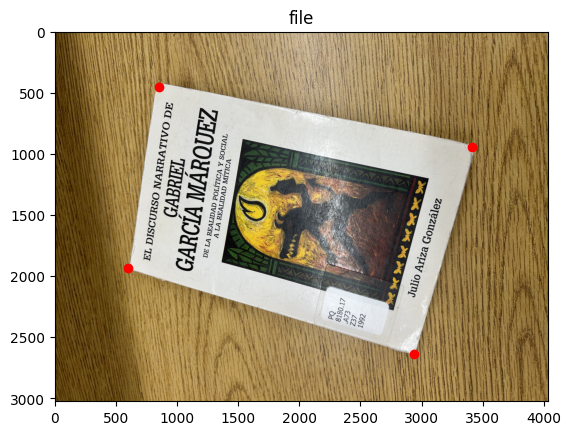

In [1]:
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

img1 = Image.open("./pic/ticket.jpg")

plt.imshow(img1)
plt.scatter([854, 3415, 2940, 600], [453, 944, 2637, 1934], c='red', marker='o')
plt.title("file")
plt.show()

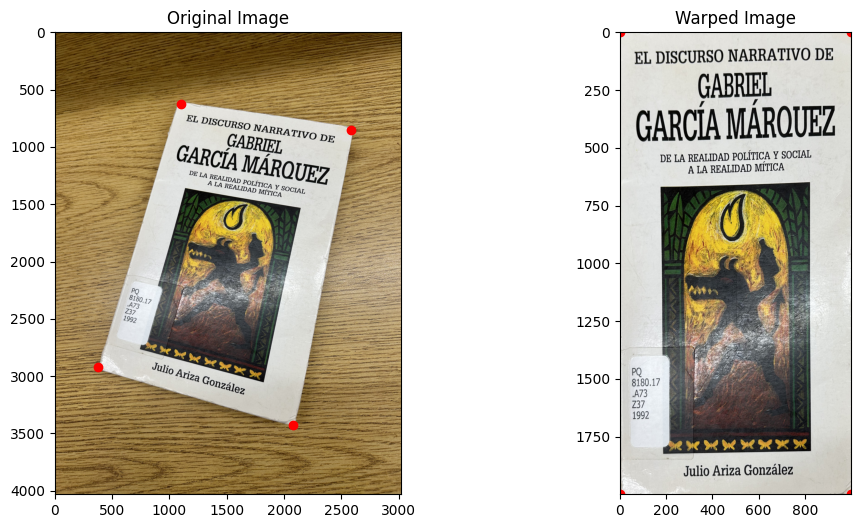

In [5]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Source and destination points
width = 1000
height = 2000
src_pts = np.array([[2581, 855], [2079, 3429], [377, 2917], [1097, 626]], dtype=np.float32)
dst_pts = np.array([[width, 0], [width, height], [0, height], [0, 0]], dtype=np.float32)

# Compute the homography matrix
H, _ = cv2.findHomography(src_pts, dst_pts)
image = cv2.imread('./pic/ticket.jpg')
warped_image = cv2.warpPerspective(image, H, (width, height))

# Display original and warped images
plt.figure(figsize=(12, 6))
plt.subplot(121)
plt.scatter(src_pts[:,0], src_pts[:,1], c='red', marker='o')
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title('Original Image')
plt.subplot(122)
plt.scatter(dst_pts[:,0], dst_pts[:,1], c='red', marker='o')
plt.imshow(cv2.cvtColor(warped_image, cv2.COLOR_BGR2RGB))
plt.title('Warped Image')
plt.show()

## Image Alignment

<div style="text-align: center;">
  <img src="./pic/KerrHall_1.jpg" style="width: 450px; display: inline-block; margin: 0 10px;" alt="Kerr Hall 1"/>
  <img src="./pic/KerrHall_2.jpg" style="width: 450px; display: inline-block; margin: 0 10px;" alt="Kerr Hall 2"/>
</div>


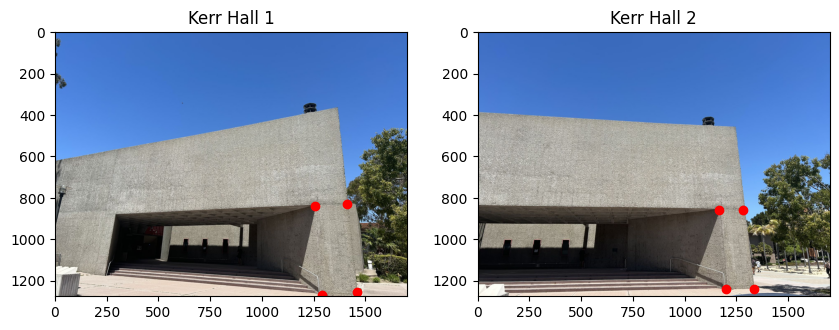

In [6]:
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

img1 = Image.open("./pic/KerrHall_1.jpg")
img2 = Image.open("./pic/KerrHall_2.jpg")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))

ax1.imshow(img1)
ax1.scatter([1256, 1289,1460,1409], [838, 1270,1257,831], c='red', marker='o')
ax1.set_title('Kerr Hall 1')

ax2.imshow(img2)
ax2.scatter([1165, 1202,1333, 1284], [857, 1241,1240, 861], c='red', marker='o')
ax2.set_title('Kerr Hall 2')

plt.show()



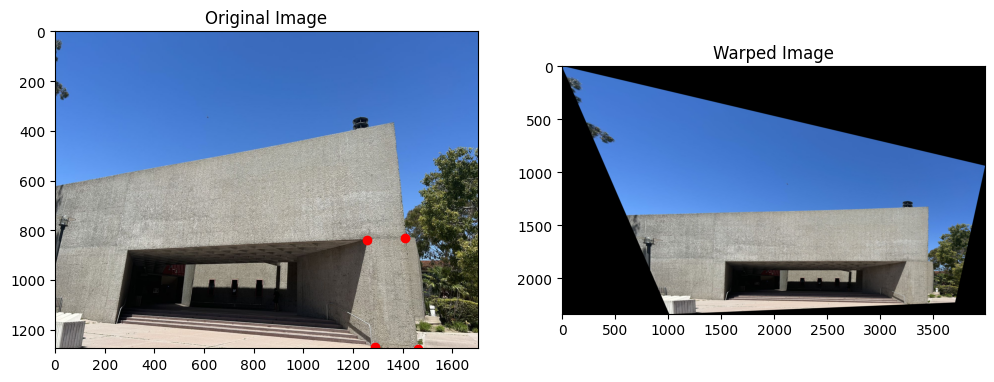

In [7]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Source and destination points
src_pts = np.array([[1256, 838], [1289, 1270], [1460, 1280], [1409, 831]], dtype=np.float32)
dst_pts = np.array([[1200, 800], [1200, 1200], [1400, 1200], [1400, 800]], dtype=np.float32)

# Compute the homography matrix
H, _ = cv2.findHomography(src_pts, dst_pts)

# Load the image
image = cv2.imread('./pic/KerrHall_1.jpg')  # Replace this path with your image path

# Calculate the new boundary
height, width = image.shape[:2]
corners = np.array([[0, 0], [width-1, 0], [width-1, height-1], [0, height-1]], dtype=np.float32).reshape(-1, 1, 2)
transformed_corners = cv2.perspectiveTransform(corners, H)

# Determine the translation needed to ensure all pixels are visible
x_min = np.min(transformed_corners[:, :, 0])
y_min = np.min(transformed_corners[:, :, 1])
translate_H = np.array([[1, 0, -x_min], [0, 1, -y_min], [0, 0, 1]])

# Adjust homography to translate the image within visible boundaries
adjusted_H = translate_H.dot(H)

# Calculate new dimensions based on the maximum extents of the transformed (and translated) corners
new_width = int(np.max(transformed_corners[:, :, 0]) - x_min)
new_height = int(np.max(transformed_corners[:, :, 1]) - y_min)

# Apply the adjusted homography
warped_image = cv2.warpPerspective(image, adjusted_H, (new_width, new_height))

# Display original and warped images
plt.figure(figsize=(12, 6))
plt.subplot(121)
plt.scatter(src_pts[:,0], src_pts[:,1], c='red', marker='o')
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title('Original Image')
plt.subplot(122)
plt.imshow(cv2.cvtColor(warped_image, cv2.COLOR_BGR2RGB))
plt.title('Warped Image')
plt.show()


Matrix H:
[[ 1.96198658e+00 -1.92135709e-02 -5.45030700e+02]
 [ 5.70940550e-01  1.39890659e+00 -4.89404955e+02]
 [ 5.36946893e-04 -4.87146980e-05  1.00000000e+00]]


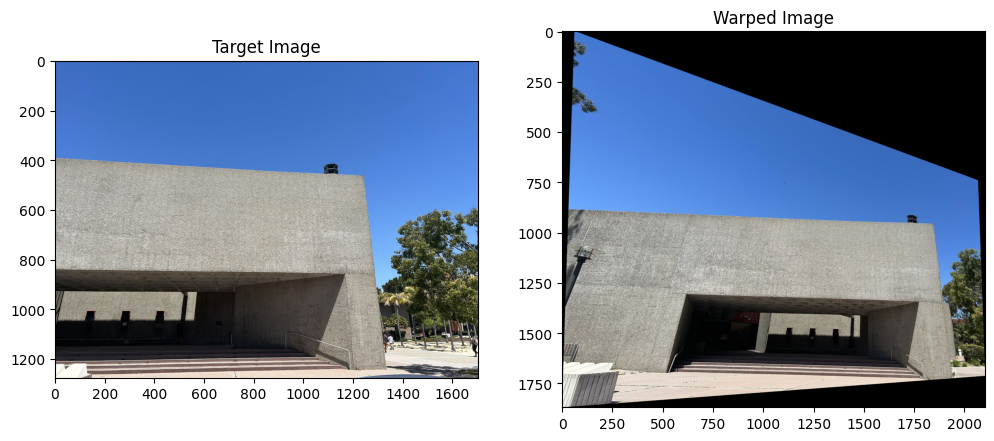

In [8]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Source and destination points
src_pts = np.array([[1256, 838], [1289, 1270], [1460, 1280], [1409, 831]], dtype=np.float32)
dst_pts = np.array([[1165, 857], [1202, 1241],[1333, 1240], [1284, 861]], dtype=np.float32)

H, _ = cv2.findHomography(src_pts, dst_pts)
print("Matrix H:")
print(H)
image = cv2.imread('./pic/KerrHall_1.jpg')
target_image = cv2.imread('./pic/KerrHall_2.jpg')
# Calculate the new boundary
height, width = image.shape[:2]
corners = np.array([[0, 0], [width-1, 0], [width-1, height-1], [0, height-1]], dtype=np.float32).reshape(-1, 1, 2)
transformed_corners = cv2.perspectiveTransform(corners, H)

x_min = np.min(transformed_corners[:, :, 0])
y_min = np.min(transformed_corners[:, :, 1])
translate_H = np.array([[1, 0, -x_min], [0, 1, -y_min], [0, 0, 1]])

adjusted_H = translate_H.dot(H)

new_width = int(np.max(transformed_corners[:, :, 0]) - x_min)
new_height = int(np.max(transformed_corners[:, :, 1]) - y_min)

warped_image = cv2.warpPerspective(image, adjusted_H, (new_width, new_height))

plt.figure(figsize=(12, 6))
plt.subplot(121)
plt.imshow(cv2.cvtColor(target_image, cv2.COLOR_BGR2RGB))
plt.title('Target Image')
plt.subplot(122)
plt.imshow(cv2.cvtColor(warped_image, cv2.COLOR_BGR2RGB))
plt.title('Warped Image')
plt.show()


## Using DLT(Directly Linear Transform) to solve the H Matrix
$\color{#EF5645}{\text{review:}}$

$$ x' = \frac{h_{11}x + h_{12}y + p_x}{v_1 x + v_2 y + 1}$$

$$ y' = \frac{h_{21}x + h_{22}y + p_y} {v_1 x + v_2 y + 1}$$

hence, we can change two equation a little:

$$ -h_{11}x - h_{12}y - h_{13} + h_{31}x x' + h_{32} y x' + h_{33}x' = 0$$

$$ -h_{21}x - h_{22}y - h_{23} + h_{31}x y' + h_{32} y y' + h_{31}y' = 0$$

Then we can write as matrix form: $Ah = 0$

$$A = \begin{bmatrix}
-x & -y & -1 & 0 & 0 & 0 & xx' & yx' & x'\\ 
0 & 0 & 0 & -x & -y & -1 & xy' & yy' & y'\\ 
\end{bmatrix}$$


$$Ah = 0$$

$$A = \begin{bmatrix}
-x & -y & -1 & 0 & 0 & 0 & xx' & yx' & x'\\ 
0 & 0 & 0 & -x & -y & -1 & xy' & yy' & y'\\ 
\end{bmatrix}$$

Where $A$ is a $2n \times 9$ matrix and $h$ is $9\times 1$ vector.

Using Singular Value Decomposition (SVD) we can write:

$$A = U \Sigma V^T$$

$V^T$ is the solution of Ah = 0

In [10]:
def compute_homography(src_pts, dst_pts):
    A = []
    for i in range(4):
        x, y = src_pts[i]
        xp, yp = dst_pts[i]
        A.append([-x, -y, -1, 0, 0, 0, x*xp, y*xp, xp])
        A.append([0, 0, 0, -x, -y, -1, x*yp, y*yp, yp])
    
    A = np.asarray(A)
    U, S, Vt = np.linalg.svd(A)
    H = Vt[-1].reshape(3, 3)
    H /= H[2, 2]
    return H

def bilinear_interpolation(image, x, y):
    i, j = int(x), int(y)
    a, b = x - i, y - j
    
    # Check bounds to ensure we don't interpolate at the edge
    if 0 <= i < image.shape[1]-1 and 0 <= j < image.shape[0]-1:
        return (1-a) * (1-b) * image[j, i] + a * (1-b) * image[j, i+1] + (1-a) * b * image[j+1, i] + a * b * image[j+1, i+1]
    else:
        return np.array([0, 0, 0], dtype=np.uint8)

def compute_transformed_bounds(img_shape, H):
    h, w, _ = img_shape

    corners = np.array([
        [0, 0, 1],
        [w-1, 0, 1],
        [w-1, h-1, 1],
        [0, h-1, 1]
    ]).T

    transformed_corners = H @ corners
    transformed_corners /= transformed_corners[2, :]

    min_x = min(transformed_corners[0])
    min_y = min(transformed_corners[1])
    max_x = max(transformed_corners[0])
    max_y = max(transformed_corners[1])

    return int(min_x), int(min_y), int(max_x), int(max_y)

def warp_image_with_bounds(img_I, H):
    min_x, min_y, max_x, max_y = compute_transformed_bounds(img_I.shape, H)
    output_height = max_y - min_y + 1
    output_width = max_x - min_x + 1

    img_S = np.zeros((output_height, output_width, 3), dtype=img_I.dtype)
    inv_H = np.linalg.inv(H)

    for i in range(output_height):
        for j in range(output_width):
            x, y, z = np.dot(inv_H, [j + min_x, i + min_y, 1])
            x /= z
            y /= z
            if 0 <= x < img_I.shape[1] and 0 <= y < img_I.shape[0]:
                img_S[i, j] = bilinear_interpolation(img_I, x, y)

    return img_S

H Matrix
[[ 1.96198658e+00 -1.92135709e-02 -5.45030700e+02]
 [ 5.70940550e-01  1.39890659e+00 -4.89404955e+02]
 [ 5.36946893e-04 -4.87146980e-05  1.00000000e+00]]


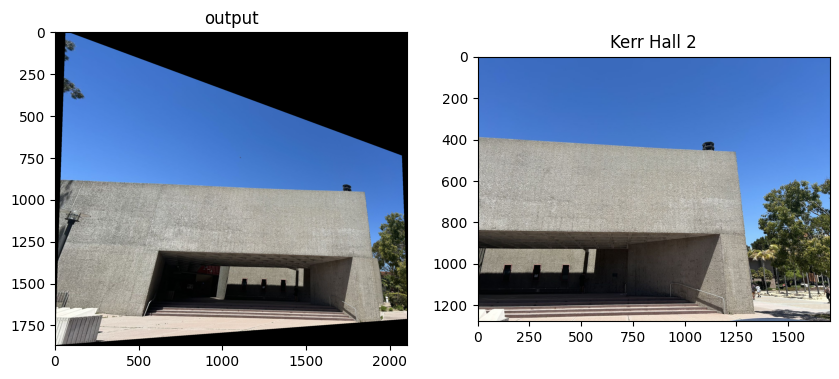

In [11]:
print('H Matrix')
# Load image I
img_I = np.array(Image.open("./pic/KerrHall_1.jpg"))[..., :3]

# Define source and destination points
src_pts = np.array([[1256, 838], [1289, 1270], [1460, 1280], [1409, 831]], dtype=np.float32)
dst_pts = np.array([[1165, 857], [1202, 1241],[1333, 1240], [1284, 861]], dtype=np.float32)

# Compute homography matrix
H = compute_homography(src_pts, dst_pts)
print(H)

# Warp image using the computed H and the new function
img_S = warp_image_with_bounds(img_I, H)

# Convert to PIL image for display and save
img_S_pil = Image.fromarray(np.uint8(img_S))

img1 = img_S_pil
img2 = Image.open("./pic/KerrHall_2.jpg")

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))

ax1.imshow(img1)
ax1.set_title('output')

ax2.imshow(img2)
ax2.set_title('Kerr Hall 2')

plt.show()

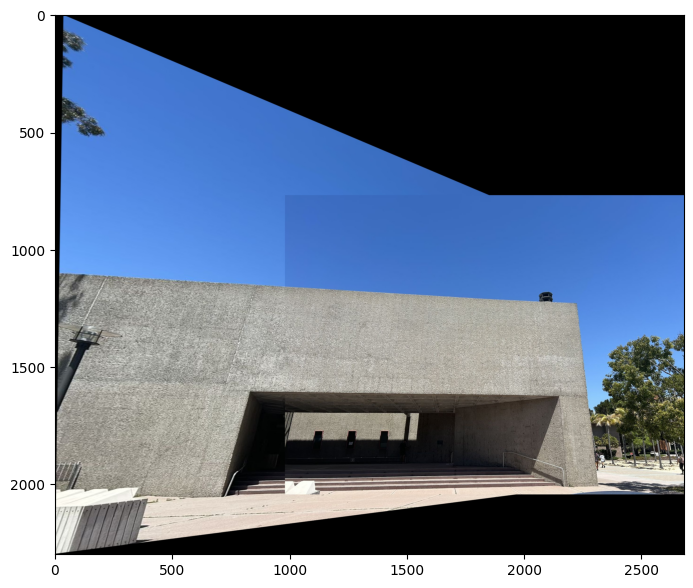

In [50]:
img = Image.open("./pic/image.jpg")
plt.imshow(img)
plt.show()

<font size="20">Image Stitching</font>



<center><img src="./pic/titleimg.jpg"  width="700" height="700"><center>

# Procedure

## In high level:

1. Identify the similar regions in two images


2. Align two images together by matching the corresponding features to minimize the distortion 


3. Blend the overlapping parts 


## In technical level:

### 1. Identify the similar regions in two images 
- $\color{#EF5645}{\text{Keypoint detection}}$ and find $\color{#EF5645}{\text{Descriptor}}$
- $\color{#EF5645}{\text{Feature matching}}$
  
### 2. Align two images together by matching the corresponding features to minimize the distortion 
- $\color{#EF5645}{\text{Image alignment}}$ 
- $\color{#EF5645}{\text{Homogeneous transformation}}$

### 3. Blend the overlapping parts
- $\color{#EF5645}{\text{Image blending}}$

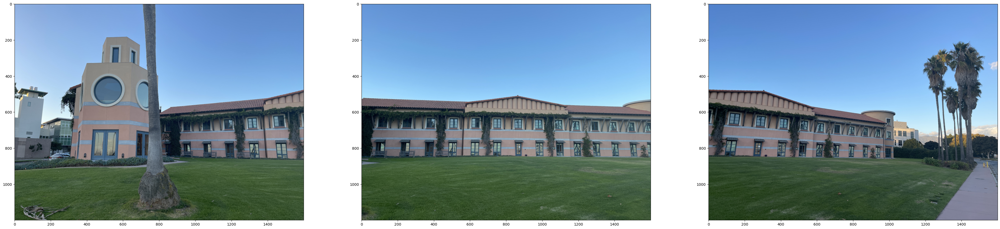

In [26]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
%matplotlib inline

img1 = cv.imread('./pic/IMG_8833.JPG')
img2 = cv.imread('./pic/IMG_8834.jpg')
img3 = cv.imread('./pic/IMG_8835.jpg')

img1 = cv.resize(img1, (1600,1200))
img2 = cv.resize(img2, (1600,1200))
img3 = cv.resize(img3, (1600,1200))

figure(figsize=(48,12))
plt.subplot(1,3,1)
plt.imshow(cv.cvtColor(img1,cv.COLOR_BGR2RGB))
plt.subplot(1,3,2)
plt.imshow(cv.cvtColor(img2,cv.COLOR_BGR2RGB))
plt.subplot(1,3,3)
plt.imshow(cv.cvtColor(img3,cv.COLOR_BGR2RGB))

## Keypoint Detection and Descriptor

Locate recognizable focal areas in an image, such as $\color{#EF5645}{\text{corners}}$ or $\color{#EF5645}{\text{edges}}$

The keypoints’ $\color{#EF5645}{\text{scale and orientation must be resistant to changes}}$ in scale and rotation

### Why do we want to find keypoints? 

 => We need them to compute the homogeneous matrix for image alignment!

## SIFT  (Scale-Invariant Feature Transform)

### Scale invariant keypoints localization
<img style="float: right;" src="./pic/SIFT_DoG.jpg"  width="700" height="700">

#### 1. Define scale pace
- Downsamping by the factor of 2 in each scale level

#### 2. Do the $\color{#EF5645}{\text{Gaussian blurring}}$ in each scale level and gradually increase the $\color{#EF5645}{\text{$\sigma$}}$

#### 3. Take the difference between blurred image and its neighbor to get the $\color{#EF5645}{\text{Difference of Gaussian (DoG) pyramid}}$

#### 4. The DoG pyramid is used to approximate the Laplacian pyramid

#### 5. Can be used to locate the interested $\color{#EF5645}{\text{keypoints}}$

#### 6. Find the local maximum/minimum by comparing with its neighboring 26 points

#### 7. Reject the local maximum/minimum with a low contrast and those on edges


<img style="float: left;" src="./pic/local_maximum.png"  width="500" height="500">


<img style="float: right;" src="./pic/Reject_criteria.png"  width="800" height="800">

#### We get the keypoints at different scales and their positions!

### keypoints Orientation
#### 1. Set a neighborhood $3*scale$ around a keypoint
   
#### 2. Compute the magnitude and orientation of the $\color{#EF5645}{\text{2D gradient}}$ at each pixel in this neighborhood.

#### 3. Apply a Gaussian filter to that region
   
#### 4. Create a $\color{#EF5645}{\text{36-bin histogram}}$ for the orientations — 10 degrees per bin.

#### 5. Create a separate keypoint if one bin is over 80% of the peak magnitude

- These keypoints will be identical except for their orientation attributes

<center><img src="./pic/orientation_hitogram.png"  width="700" height="700"><center>

### At this point, each keypoint has a location, scale, orientation

<img style="float: right;" src="./pic/keypoint_descriptor.png"  width="500" height="500">

### Define a descriptor for each keypoint

#### 1. Set a $16 * 16$ window around the keypoint. It is divided into $16$ sub-blocks of $4 * 4$ size.

#### 2. For each sub-block, $8$ bin orientation histogram is created.
#### 3. $8 * 16 = \color{#EF5645}{\text{128}}$ dimension of descriptor is created


In [27]:
gray_1 = cv.cvtColor(img1,cv.COLOR_BGR2GRAY)
gray_2 = cv.cvtColor(img2,cv.COLOR_BGR2GRAY)
gray_3 = cv.cvtColor(img3,cv.COLOR_BGR2GRAY)

In [28]:
sift = cv.SIFT.create()
kpt1, descriptor1 = sift.detectAndCompute(gray_1, None)
kpt2, descriptor2 = sift.detectAndCompute(gray_2, None)

## Feature Matching

### Match the keypoints

### Matcher Type

#### 1. Brute force
- Try all possibilities in another image and will find the best matches

#### 2. FLANN (Fast Library for Approximate Nearest Neighbors)
- Much faster but will only find an approximate nearest neighbor
- Could be a good match but not necessarily the best one

### Match method

#### 1. *match( )* : 
- Return the best match


#### 2. *knnMatch( )* : 
- Return k best matches
- To prevent ambiguity, reject the keypoint with multiple similar matches

In [29]:
def BF_match(descriptor1, descriptor2):
    bf = cv.BFMatcher.create(cv.NORM_L2, crossCheck= True)
    matches = bf.match(descriptor1, descriptor2)
    matches = sorted(matches, key = lambda x: x.distance)[:50]
    return matches

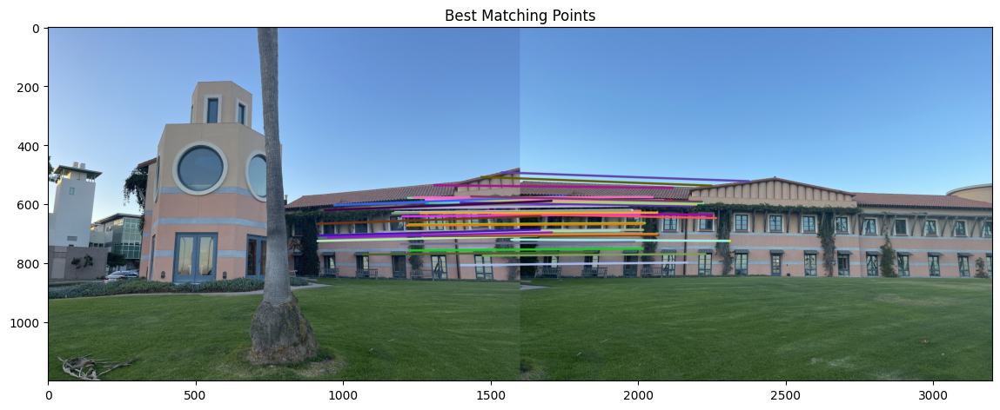

In [17]:
bf_matches = BF_match(descriptor1, descriptor2)
result = cv.drawMatches(img1, kpt1, img2, kpt2, bf_matches, None, matchesThickness = 5, flags = 2)

# Display the best matching points
plt.rcParams['figure.figsize'] = [14.0, 7.0]
plt.title('Best Matching Points')
plt.imshow(cv.cvtColor(result,cv.COLOR_BGR2RGB),aspect = 1)
plt.show()

In [18]:
def FLANN_match(descriptor1, descriptor2):
    matcher = cv.DescriptorMatcher.create(cv.DescriptorMatcher_FLANNBASED)
    if (descriptor1 is not None and descriptor2 is not None and len(descriptor1) >=2 and len(descriptor2) >= 2):
        rawMatch = matcher.knnMatch(descriptor1, descriptor2, k=2)
        
    matches = []
    # Ensure the distance is within a certain ratio of each other (i.e. Lowe's ratio test)
    ratio = 0.75
    for m in rawMatch:
        if len(m) == 2 and m[0].distance < m[1].distance * ratio:
            matches.append(m[0])
    matches = sorted(matches, key = lambda x: x.distance)[:50]
    return matches

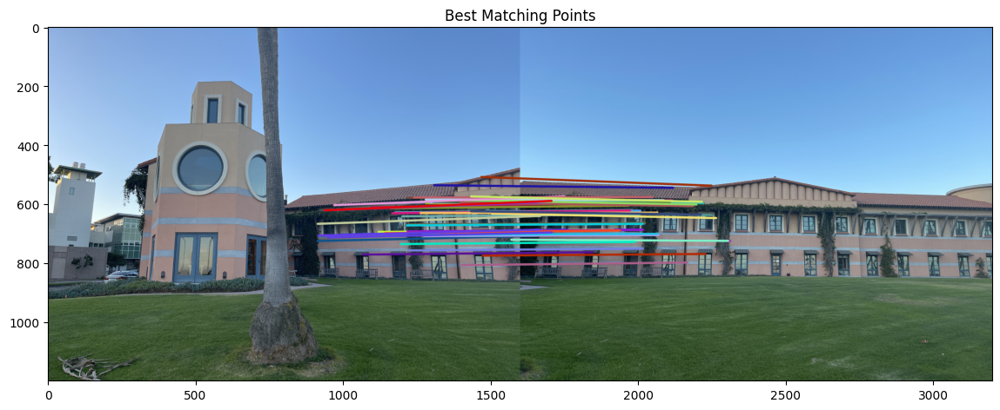

In [19]:
flann_matches = FLANN_match(descriptor1, descriptor2)
result = cv.drawMatches(img1, kpt1, img2, kpt2, flann_matches, None, matchesThickness = 5, flags = 2)

# Display the best matching points
plt.rcParams['figure.figsize'] = [14.0, 7.0]
plt.title('Best Matching Points')
plt.imshow(cv.cvtColor(result,cv.COLOR_BGR2RGB),aspect = 1)
plt.show()

In [30]:
# Use brute force matcher
matches = BF_match(descriptor1, descriptor2)
# Load the coordinates of matched keypoint pairs
kpt1_coord = []
kpt2_coord = []
for match in matches:
    
    (x1,y1) = kpt1[match.queryIdx].pt
    (x2,y2) = kpt2[match.trainIdx].pt
    kpt1_coord.append([x1,y1])
    kpt2_coord.append([x2,y2])

kpt1_coord = np.float32(kpt1_coord).reshape((-1,1,2))
kpt2_coord = np.float32(kpt2_coord).reshape((-1,1,2))
  

### Now, we have the keypoints of both images.

### Next, we compute the homogeneous matrix for aligning ***img1(left)*** to ***img2(right)***

## Image Alignment

### Homography

In [31]:
H, _ = cv.findHomography(kpt1_coord,kpt2_coord,method = cv.RANSAC,ransacReprojThreshold = 3)

#### After **$\color{#EF5645}{\text{homogeneous transformation}}$**, we've already $\color{#EF5645}{\text{moved}}$ the keypoints in ***img1*** to the $\color{#EF5645}{\text{possition}}$ of their corresponding keypoints in ***img2***.

#### Therefore, we don't need to worry about what if they dont't align with each other after warping the image.

#### Sounds like we just need to blend these two images, and the work is done.

#### But, life is not that easy

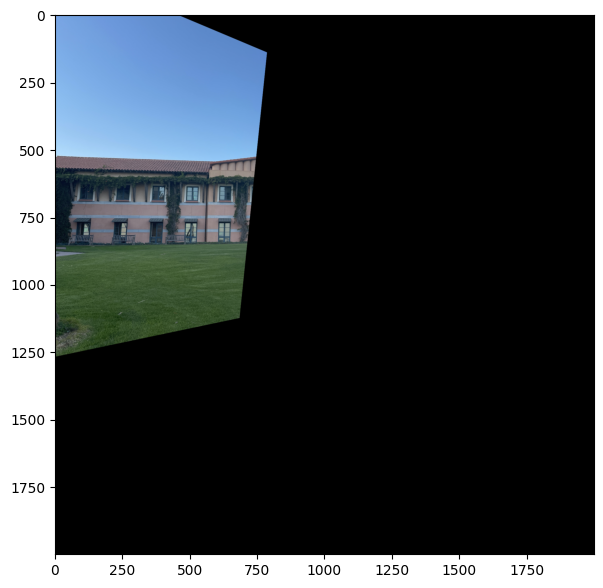

In [32]:
trans1_notranslation = cv.warpPerspective(img1, H, (2000, 2000))
plt.imshow(cv.cvtColor(trans1_notranslation, cv.COLOR_BGR2RGB))

#### Compute how much we need to shift and build a translation matrix

In [33]:
def translate_H(image, H):
    height = image.shape[0]
    width = image.shape[1]
    corners = np.array([[0, 0, 1],[width-1, 0, 1],[0, height-1, 1],[width-1, height-1, 1]], dtype = 'float32').T
    transformed_corners = H@corners
    transformed_corners /= transformed_corners[-1, :]
    minx = np.min(transformed_corners[0, :])
    miny = np.min(transformed_corners[1, :])
    maxx = np.max(transformed_corners[0, :])
    maxy = np.max(transformed_corners[1, :])

    smallest_x = int(np.floor(minx))
    smallest_y = int(np.floor(miny))
    
    # Move the left-bottom point to the first quadrant
    # Remain unchanged if the left-bottom point already at first quadrant, 
    translate_x = -smallest_x if smallest_x < 0 else 0
    translate_y = -smallest_y if smallest_y < 0 else 0
    translate_H = np.array([[1, 0, translate_x], [0, 1, translate_y], [0, 0, 1]], dtype = 'float32')
    return translate_H

#### Compute the overall bounding box of the panorama

In [34]:
def transformed_boundingbox(img1, img2, H):
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    ptsA = np.float32([[0, 0], [0, h1], [w1, 0], [w1, h1]]).reshape(-1, 1, 2)
    ptsA_ = cv.perspectiveTransform(ptsA, H)
    ptsB = np.float32([[0, 0], [0, h2], [w2, 0], [w2, h2]]).reshape(-1, 1, 2)
    
    # Use bult-in fuction boundingRect for computing the bounding box
    pts = np.concatenate((ptsA_, ptsB), axis=0)
    [x_min, y_min, w, h] = cv.boundingRect(pts)
    return h, w

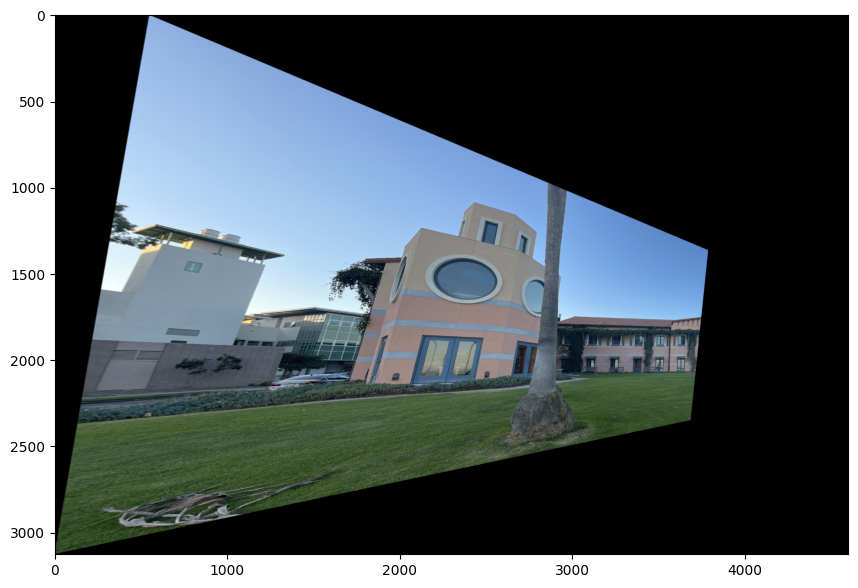

In [35]:
height, width = transformed_boundingbox(gray_1, gray_2, H)

translation = translate_H(gray_1, H)
H_corr = translation@H

transformed_1to2 = cv.warpPerspective(img1, H_corr, (width,height))
plt.imshow(cv.cvtColor(transformed_1to2, cv.COLOR_BGR2RGB))

### The img1 is translated to the observable position, and img2 also have to be shifted by the same value to keep their keypoints matched.

### Apply the corrected homogeneous matrix to both images

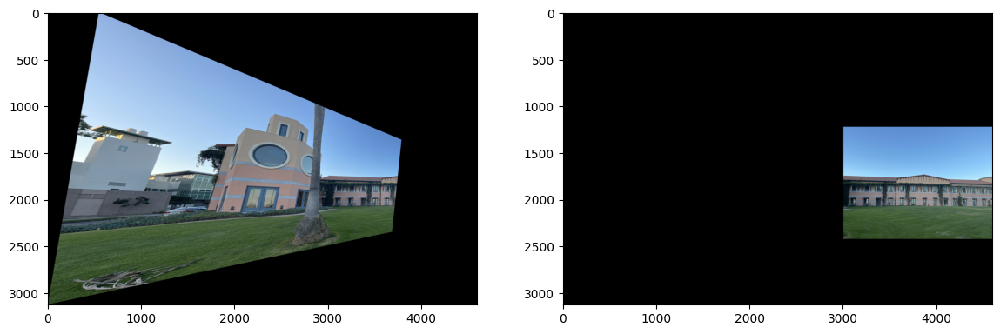

In [36]:
H_corr = translation@H
transformed_1to2 = cv.warpPerspective(img1, H_corr, (width,height))
translated_img2 = cv.warpPerspective(img2, translation , (width,height))

plt.subplot(1,2,1)
plt.imshow(cv.cvtColor(transformed_1to2, cv.COLOR_BGR2RGB))
plt.subplot(1,2,2)
plt.imshow(cv.cvtColor(translated_img2, cv.COLOR_BGR2RGB))

## Image Blending 

### Alpha blending

blend = α * img1 + (1-α) * img2

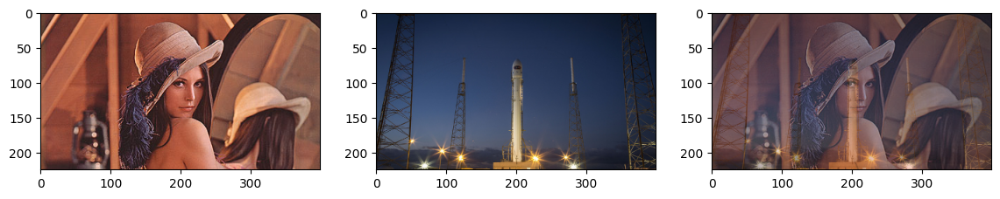

In [37]:
src1 = cv.imread('pic/lena.jpg')
src2 = cv.imread('pic/rocket.jpg')

src2 = cv.resize(src2, src1.shape[1::-1])
blended_pic = cv.addWeighted(src1, 0.5, src2, 0.5, 0)
plt.subplot(1,3,1)
plt.imshow(cv.cvtColor(src1, cv.COLOR_BGR2RGB))
plt.subplot(1,3,2)
plt.imshow(cv.cvtColor(src2, cv.COLOR_BGR2RGB))
plt.subplot(1,3,3)
plt.imshow(cv.cvtColor(blended_pic, cv.COLOR_BGR2RGB))

<center><img src="./pic/image_blend method.jpg"  width="700" height="700"><center>

In [38]:
# only the non-zero pixels are weighted to the average
def mean_blend(img1, img2):
    assert(img1.shape == img2.shape)
    locs1 = np.where(cv.cvtColor(img1, cv.COLOR_RGB2GRAY) != 0)
    blended1 = np.copy(img2)
    blended1[locs1[0], locs1[1]] = img1[locs1[0], locs1[1]]
    locs2 = np.where(cv.cvtColor(img2, cv.COLOR_RGB2GRAY) != 0)
    blended2 = np.copy(img1)
    blended2[locs2[0], locs2[1]] = img2[locs2[0], locs2[1]]
    blended = cv.addWeighted(blended1, 0.5, blended2, 0.5, 0)
    return blended

In [39]:
combined_1and2 = mean_blend(transformed_1to2, translated_img2)

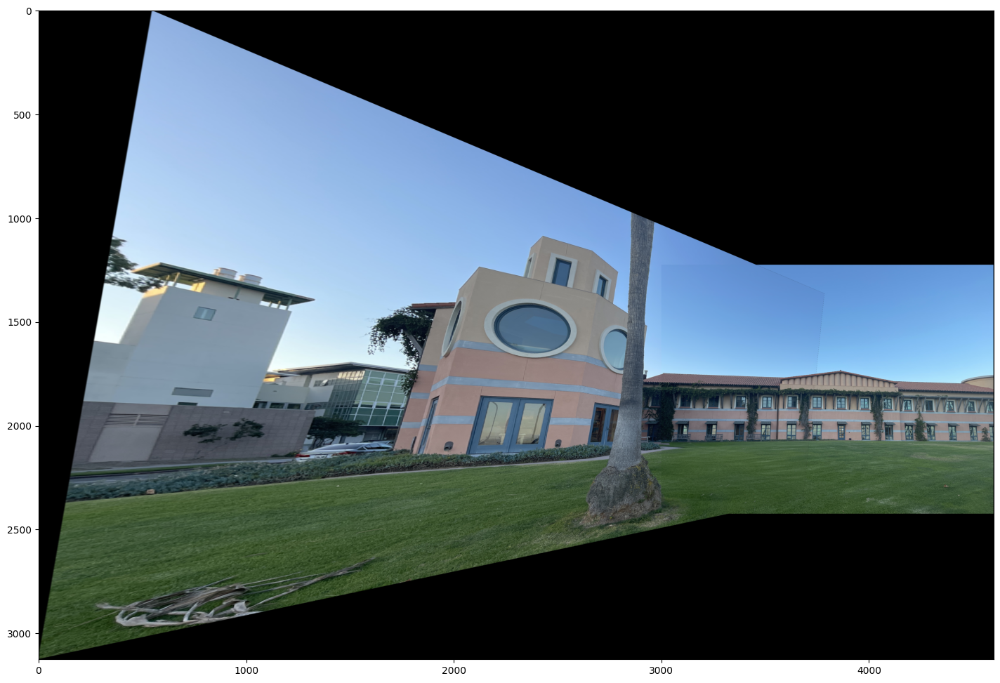

In [40]:
figure(figsize=(48,12))
plt.imshow(cv.cvtColor(combined_1and2,cv.COLOR_BGR2RGB))

### Stitch img3 and the composite of img1 and img2 together

In [41]:
# Convert the composite of img1 and img2 to gray scale
gray_1and2 = cv.cvtColor(combined_1and2,cv.COLOR_BGR2GRAY)

# Use SIFT to find the keypoints and descriptors
kpt1and2, descriptor1and2 = sift.detectAndCompute(gray_1and2, None)
kpt3, descriptor3 = sift.detectAndCompute(gray_3, None)

bf = cv.BFMatcher()
# Brute force match the composite and img3
matches = bf.match(descriptor1and2, descriptor3)
matches = sorted(matches, key = lambda x: x.distance)[:50]

# Load the coordinates of matched keypoint pairs
kpt1and2_coord = []
kpt3_coord = []
for match in matches:
    
    (x1,y1) = kpt1and2[match.queryIdx].pt
    (x2,y2) = kpt3[match.trainIdx].pt
    kpt1and2_coord.append([x1,y1])
    kpt3_coord.append([x2,y2])

kpt1and2_coord = np.float32(kpt1and2_coord).reshape((-1,1,2))
kpt3_coord = np.float32(kpt3_coord).reshape((-1,1,2))

# Compute the homogeneous matrix for transforming img3 to the composite 
H, _ = cv.findHomography(kpt3_coord, kpt1and2_coord, method = cv.RANSAC, ransacReprojThreshold = 3)

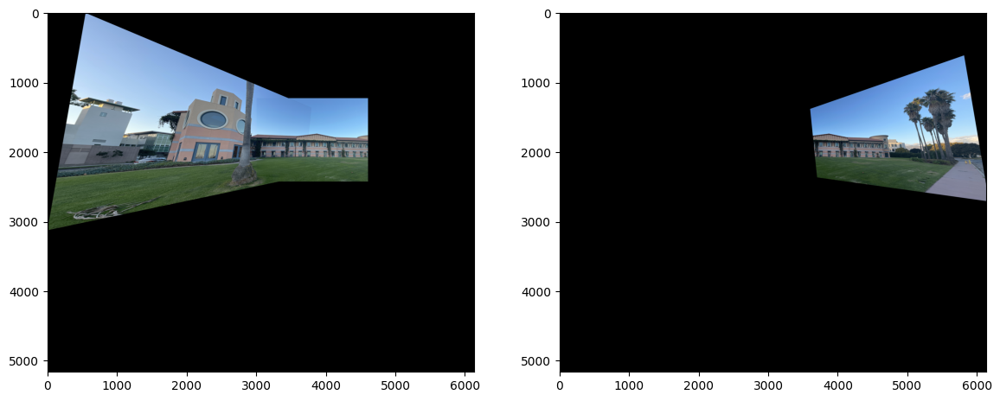

In [42]:
height, width = transformed_boundingbox(gray_1and2, gray_3, H)

translation = translate_H(gray_3, H)
H_corr = translation@H

transformed_3 = cv.warpPerspective(img3, H_corr, (width,height))
translated_1and2 = cv.warpPerspective(combined_1and2, translation , (width,height))

plt.subplot(1,2,1)
plt.imshow(cv.cvtColor(translated_1and2,cv.COLOR_BGR2RGB))
plt.subplot(1,2,2)
plt.imshow(cv.cvtColor(transformed_3,cv.COLOR_BGR2RGB))

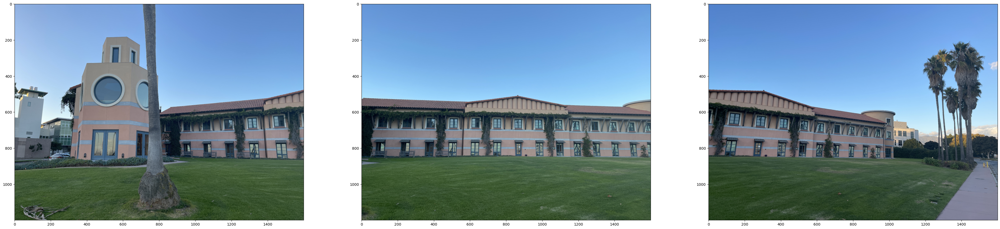

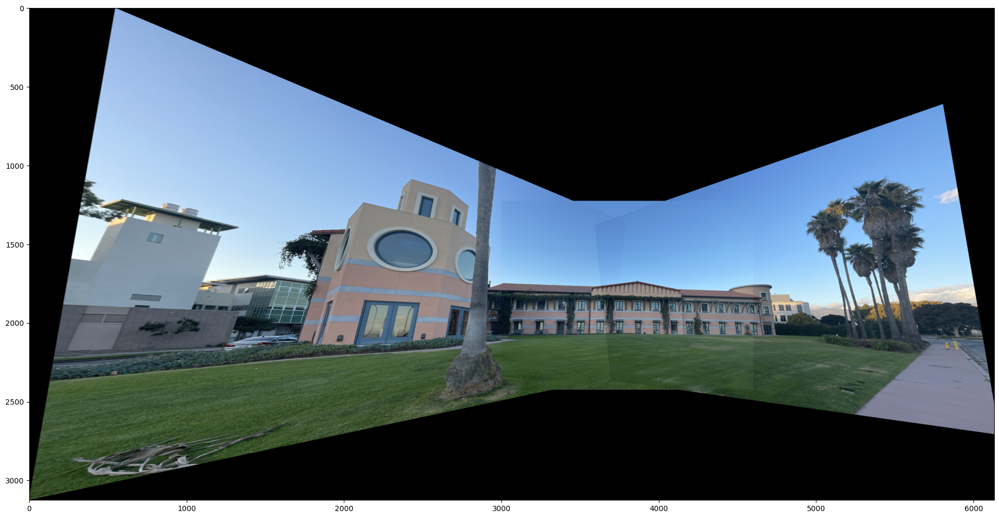

In [43]:
final_result = mean_blend(transformed_3, translated_1and2)

figure(figsize=(48,12))
plt.subplot(1,3,1)
plt.imshow(cv.cvtColor(img1,cv.COLOR_BGR2RGB))
plt.subplot(1,3,2)
plt.imshow(cv.cvtColor(img2,cv.COLOR_BGR2RGB))
plt.subplot(1,3,3)
plt.imshow(cv.cvtColor(img3,cv.COLOR_BGR2RGB))

def crop(image):
    y_nonzero, x_nonzero, _ = np.nonzero(image)
    return image[np.min(y_nonzero):np.max(y_nonzero), np.min(x_nonzero):np.max(x_nonzero)]

final_result = crop(final_result)
figure(figsize=(48,12))
plt.imshow(cv.cvtColor(final_result,cv.COLOR_BGR2RGB))

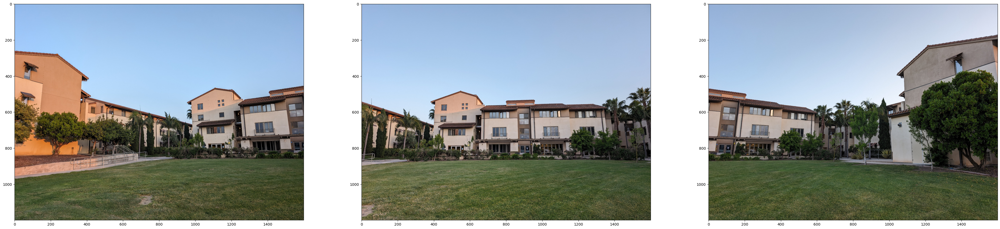

In [46]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
%matplotlib inline
img1 = cv.imread('pic/scv/left.JPG')
img2 = cv.imread('pic/scv/center.jpg')
img3 = cv.imread('pic/scv/right.jpg')

img1 = cv.resize(img1, (1600,1200))
img2 = cv.resize(img2, (1600,1200))
img3 = cv.resize(img3, (1600,1200))

figure(figsize=(48,12))
plt.subplot(1,3,1)
plt.imshow(cv.cvtColor(img1,cv.COLOR_BGR2RGB))
plt.subplot(1,3,2)
plt.imshow(cv.cvtColor(img2,cv.COLOR_BGR2RGB))
plt.subplot(1,3,3)
plt.imshow(cv.cvtColor(img3,cv.COLOR_BGR2RGB))

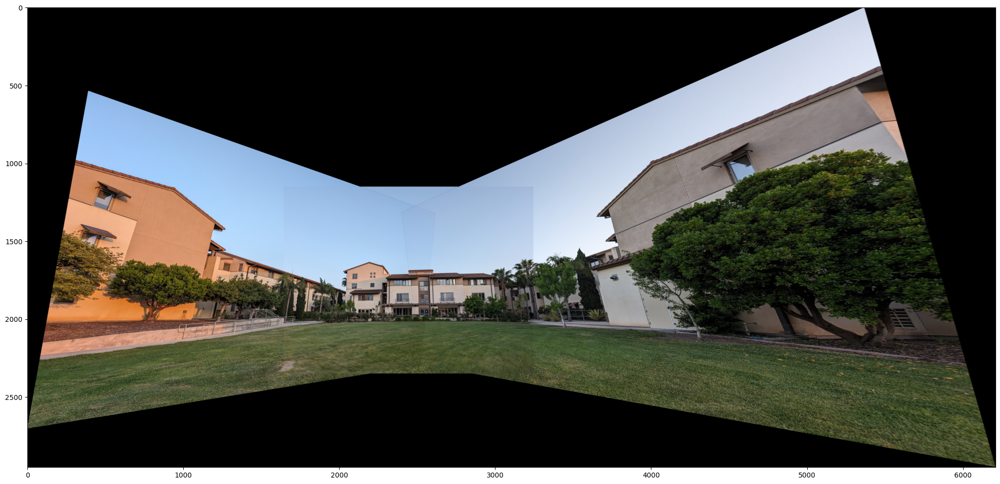

In [47]:
gray_1 = cv.cvtColor(img1,cv.COLOR_BGR2GRAY)
gray_2 = cv.cvtColor(img2,cv.COLOR_BGR2GRAY)
gray_3 = cv.cvtColor(img3,cv.COLOR_BGR2GRAY)

sift = cv.SIFT.create()
kpt1, descriptor1 = sift.detectAndCompute(gray_1, None)
kpt2, descriptor2 = sift.detectAndCompute(gray_2, None)

def BF_match(descriptor1, descriptor2):
    bf = cv.BFMatcher.create(cv.NORM_L2, crossCheck= True)
    matches = bf.match(descriptor1, descriptor2)
    matches = sorted(matches, key = lambda x: x.distance)[:50]
    return matches

def translate_H(image, H):
    height = image.shape[0]
    width = image.shape[1]
    corners = np.array([[0, 0, 1],[width-1, 0, 1],[0, height-1, 1],[width-1, height-1, 1]], dtype = 'float32').T
    transformed_corners = H@corners
    transformed_corners /= transformed_corners[-1, :]
    minx = np.min(transformed_corners[0, :])
    miny = np.min(transformed_corners[1, :])
    maxx = np.max(transformed_corners[0, :])
    maxy = np.max(transformed_corners[1, :])
    
    smallest_x = int(np.floor(minx))
    smallest_y = int(np.floor(miny))    
    # Move the left-bottom point to the first quadrant
    # Remain unchanged if the left-bottom point already at first quadrant, 
    translate_x = -smallest_x if smallest_x < 0 else 0
    translate_y = -smallest_y if smallest_y < 0 else 0
    translate_H = np.array([[1, 0, translate_x], [0, 1, translate_y], [0, 0, 1]], dtype = 'float32')
    return translate_H

def transformed_boundingbox(img1, img2, H):
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    ptsA = np.float32([[0, 0], [0, h1], [w1, 0], [w1, h1]]).reshape(-1, 1, 2)
    ptsA_ = cv.perspectiveTransform(ptsA, H)
    ptsB = np.float32([[0, 0], [0, h2], [w2, 0], [w2, h2]]).reshape(-1, 1, 2)
    
    # Use bult-in fuction boundingRect for computing the bounding box
    pts = np.concatenate((ptsA_, ptsB), axis=0)
    [x_min, y_min, w, h] = cv.boundingRect(pts)
    return h, w

def mean_blend(img1, img2):
    assert(img1.shape == img2.shape)
    locs1 = np.where(cv.cvtColor(img1, cv.COLOR_RGB2GRAY) != 0)
    blended1 = np.copy(img2)
    blended1[locs1[0], locs1[1]] = img1[locs1[0], locs1[1]]
    locs2 = np.where(cv.cvtColor(img2, cv.COLOR_RGB2GRAY) != 0)
    blended2 = np.copy(img1)
    blended2[locs2[0], locs2[1]] = img2[locs2[0], locs2[1]]
    blended = cv.addWeighted(blended1, 0.5, blended2, 0.5, 0)
    return blended

def crop(image):
    y_nonzero, x_nonzero, _ = np.nonzero(image)
    return image[np.min(y_nonzero):np.max(y_nonzero), np.min(x_nonzero):np.max(x_nonzero)]

matches = BF_match(descriptor1, descriptor2)

kpt1_coord = []
kpt2_coord = []
for match in matches:
    
    (x1,y1) = kpt1[match.queryIdx].pt
    (x2,y2) = kpt2[match.trainIdx].pt
    kpt1_coord.append([x1,y1])
    kpt2_coord.append([x2,y2])

kpt1_coord = np.float32(kpt1_coord).reshape((-1,1,2))
kpt2_coord = np.float32(kpt2_coord).reshape((-1,1,2))

H, _ = cv.findHomography(kpt1_coord,kpt2_coord,method = cv.RANSAC,ransacReprojThreshold = 3)
height, width = transformed_boundingbox(gray_1, gray_2, H)

translation = translate_H(gray_1, H)
H_corr = translation@H

transformed_1to2 = cv.warpPerspective(img1, H_corr, (width,height))
translated_img2 = cv.warpPerspective(img2, translation , (width,height))

combined_1and2 = mean_blend(transformed_1to2, translated_img2)
################################################################################################################################
gray_1and2 = cv.cvtColor(combined_1and2,cv.COLOR_BGR2GRAY)
kpt1and2, descriptor1and2 = sift.detectAndCompute(gray_1and2, None)
kpt3, descriptor3 = sift.detectAndCompute(gray_3, None)
matches = BF_match(descriptor1and2, descriptor3)
matches = sorted(matches, key = lambda x: x.distance)[:50]

kpt1and2_coord = []
kpt3_coord = []
for match in matches:
    
    (x1,y1) = kpt1and2[match.queryIdx].pt
    (x2,y2) = kpt3[match.trainIdx].pt
    kpt1and2_coord.append([x1,y1])
    kpt3_coord.append([x2,y2])

kpt1and2_coord = np.float32(kpt1and2_coord).reshape((-1,1,2))
kpt3_coord = np.float32(kpt3_coord).reshape((-1,1,2))

H, _ = cv.findHomography(kpt3_coord, kpt1and2_coord, method = cv.RANSAC, ransacReprojThreshold = 3)

height, width = transformed_boundingbox(gray_1and2, gray_3, H)

translation = translate_H(gray_3, H)
H_corr = translation@H

transformed_3 = cv.warpPerspective(img3, H_corr, (width,height))
translated_1and2 = cv.warpPerspective(combined_1and2, translation , (width,height))

final_result = mean_blend(transformed_3, translated_1and2)

final_result = crop(final_result)
figure(figsize=(48,12))
plt.imshow(cv.cvtColor(final_result,cv.COLOR_BGR2RGB))

### Other Things to try on:

### Feature Detection
#### 1. SURF (Speeded Up Robust Features)
#### 2. ORB (Orientated FAST and Robust BRIEF)

### Image Blending
#### 1.  Poisson blending
#### 2. Pyramid blending
#### 3. Multi-band blending

# An effective feature detection approach for image stitching of near-uniform scenes

### Authors: Tze Kian Jong and David B.L. Bong

### Journal: Signal Processing: Image Communication, Volume 110, January 2023

### Goal: Proposes a method to improve image stitching for scenes with minimal variations in texture (**near-uniform scenes**)

## Challenges of Stitching Near-Uniform Scenes

### * Traditional feature detectors rely on finding distinctive points in an image (corners, edges, blobs)
### * Near-uniform scenes lack these variations, making it difficult to find good matches between images
### * Example scenes: Walls, clear skies, deserts, sandy beaches
### * Inaccurate feature matching leads to misalignment and distortions in the final stitched image

## Proposed Feature Detection Approach

### * **Log-Gabor filters** are specifically designed to capture local spatial frequencies and orientations within an image
### * Unlike traditional methods relying on intensity variations, Log-Gabor filters are more effective in extracting distinctive features even in near-uniform scenes
### * The method utilizes multiple scales and orientations of Log-Gabor filters to capture a wider range of potential features

## Understanding Log-Gabor Filters

#### * A variation of Gabor filters where the output is passed through a logarithmic function
#### * Constructed in two components: the radial component and the angular component (regulate the frequency band and the orientation of the filter response, respectively)
#### * Reduce redundancy in representing image information compared to Gabor filters

## Feature Detection with Log-Gabor Filters

### * The proposed method convolves the image with multiple Log-Gabor filters at different scales and orientations.
### * The convolution process highlights regions in the image that resonate with the specific frequency and orientation of the filter.
### * Local maxima in the filtered image are identified as potential feature points.

<img src="https://ars.els-cdn.com/content/image/1-s2.0-S0923596522001515-gr1_lrg.jpg" width="300" height="500">

## Feature Description

### Dominant Orientation:
#### * For each identified feature point, the method analyzes the responses of Log-Gabor filters at different orientations
#### * The orientation that produces the strongest response is considered the dominant orientation of the feature
#### * This helps capture the local structure around the feature point

### Description Vectors:
#### * A descriptor vector is created for each feature point to encode its characteristics
#### * Include information like local intensity variations or responses from specific Log-Gabor filters at different scales and orientations
#### * These descriptors will be used later for matching corresponding features between images

## Image Stitching

### * Once features are detected and described in each image, the method performs matching to find corresponding features between images
### * Feature descriptors are compared to identify potential matches based on similarity metrics

<img src="https://ars.els-cdn.com/content/image/1-s2.0-S0923596522001515-gr2_lrg.jpg" width="300" height="500">

## Evaluation metrics

### Recall Measure (RC): a ratio between the number of inliers and the number of corresponding points visible in two overlapping images

### Spread-Overlap Measure (SO): spatial distribution within the overlapping region of the same scene

### RC/SO Score: a ratio between RC and SO

<img src="https://ars.els-cdn.com/content/image/1-s2.0-S0923596522001515-gr3_lrg.jpg" width="800" height="200">

<img src="https://ars.els-cdn.com/content/image/1-s2.0-S0923596522001515-gr8_lrg.jpg" width="800" height="600">

<img src="https://ars.els-cdn.com/content/image/1-s2.0-S0923596522001515-gr9_lrg.jpg" width="800" height="600">

<img src="https://ars.els-cdn.com/content/image/1-s2.0-S0923596522001515-gr10_lrg.jpg" width="800" height="600">

## Conclusion

### * Traditional methods struggle with these scenes due to the lack of distinctive features
### * Log-Gabor filters effectively capture local spatial frequencies and orientations, even in scenes with minimal texture variations
### * The LGFT method achieves improved stitching accuracy, a higher number of inliers, and better handling of limited texture variations compared to traditional methods